In [23]:
from inference import InferenceRoseDisease, ImageVisualizer

cfg_file = r"configs\Base-TridentNet-Fast-C4.yaml"
crop_weight = r'weights_from_online\STEP1_PETAL_CROP_TRIDENTENT.pth'
petal_weights_file = r'weights_from_online\STEP2_PETAL_SEG_REGNETX_032_UNET.ckpt'
diease_weights_file = r'logs\EX-2025-04-12-step3(disease_seg)_resnet50_unet\version_2\checkpoints\epoch=99-step=26200.ckpt'
infer = InferenceRoseDisease(
            cfg_file,
            petal_encoder_name="timm-regnetx_032",
            petal_decoder_name="unet",
            disease_encoder_name='timm-regnetx_064',
            disease_decoder_name="manet",
            crop_weight=crop_weight,
            petal_weights_file=petal_weights_file,
            diease_weights_file=diease_weights_file,
            device="cuda:1",
            box_threshold=0.5,
            crop_img_size=(256, 256),
            mask_threshold=0.1,
            img_dir=None, 
            img_file=None)
# model_path = r'logs\EX-2025-03-10-step3(disease seg)\version_12\checkpoints\epoch=51-step=37596.ckpt'
# val_img_dir = r"data\petals_data\val\img"
# val_mask_dir = r"data\petals_data\val\img"
# visualize_predictions(model_path, val_img_dir, val_mask_dir, encoder_name, out_classes=out_classes)

In [26]:
save_dir = r"./demo/demo90"
# all_img_dir = \
# [os.path.join(r"D:\2025\data\petal_from_cxq\60h", i) for i in os.listdir(r"D:\2025\data\petal_from_cxq\60h")] + \
# [os.path.join(r"D:\2025\data\petal_from_cxq\72h", i) for i in os.listdir(r"D:\2025\data\petal_from_cxq\72h")] 
# for j in all_img_dir:
infer.step1_crop_img(img_file=r"D:\2025\data\petal_from_fzj\fzj2.png", save_dir=save_dir)
import os
for i in [os.path.join(save_dir, j) for j in os.listdir(save_dir)]:
    if i.endswith('jpg'):
        infer.step2_seg_petal(
            img_file=i, save_dir=os.path.join(save_dir, 'petal_seg'))
for i in [os.path.join(save_dir, j) for j in os.listdir(save_dir)]:
    if i.endswith('jpg'):
        infer.step3_seg_disease(
            img_file=i, save_dir=os.path.join(save_dir, 'disease_seg'))

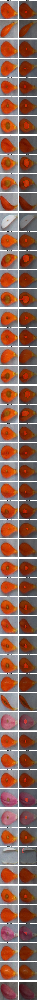

In [27]:
from utils.vis import merge_image_with_mask

merge_image_with_mask(
    f'demo\demo90',
    f'demo\demo90\disease_seg', 
    '#FF0000',
    alpha=0.4
)

